# Finding a latent space representation conditioned on pose
### WIth feature, pixel, and target propagation loss and automatic cropping with dlib
### Conditioning StyleGan using 132D input representing 68 facial landmark coordinates
### Using the FaceSpace API

In [1]:
%load_ext autoreload
%autoreload 2
from FaceSpace import GetFramesFromVideo, PreprocessFaceDir, MakeFaceData, MakeFaceModel, TrainFaceModel
from FaceSpace import SaveFaceSpace, LoadFaceSpace, GetFaceFromZSpace, ShowFace, TransferLandmarks

from train_latent_space import TrainLatentsEnc
from get_features import MakeFeatureModel, GetFeatures

from plot_utils import ShowModelOutput
from matplotlib import pyplot as plt

from scipy.stats import ortho_group
import numpy as np
import torch
import torch.nn as nn
import time
import functools

### Extract frames from video; preprocess raw frames to get cropped, aligned photos
#### Frames should contain a variety of poses belonging to the same identity (one person, many poses)

In [ ]:
VideoPath = 'Pose Transfer/tsehao2.mp4'
FramesDir = 'Pose Transfer/frames2'
GetFramesFromVideo(VideoPath, FramesDir, StartFrame=0, StopFrame=None, FrameStep=3, Rotate=90)

In [ ]:
RawImagesPath = 'Pose Transfer/frames2'
AlignedImagesPath = 'Pose Transfer/frames2/aligned'
PreprocessFaceDir(RawImagesPath, AlignedImagesPath)

### Make FaceData object based on aligned images
#### FaceData contains Wspace representing pose vectors
#### Make a W_ID attribute representing an identity vector to be learned

In [ ]:
TseData = MakeFaceData(AlignedFaceDir='Pose Transfer/frames2/aligned', Zdims=68*2, UseCuda=False,
                       GetFacesFeatures=False, GetLandmarks=False, PrintInterval=10)
TseData.W_ID = torch.zeros(1, 18, 512)
TseData.W_ID.requires_grad = True
# Don't initialise pose vectors to zero, this destroys gradients after one epoch for some reason
TseData.Wspace = torch.ones_like(TseData.Wspace)*0.01
TseData.Wspace.requires_grad = True

### Initialise the StyleGAN model
#### Only the synthesis network is required for pose transfer

In [5]:
FaceModel = MakeFaceModel(Zdims=1, Landmarks=True).g_all.g_synthesis

### Training function for learning an identity vector and pose vectors
#### Pose vectors are contained in Wspace attribute
#### Size of learned pose vector is regularised by including norm of each pose vector in the loss function to ensure each pose exists within a neighbourhood of the learned identity vector

In [19]:
def TrainLatentsEnc(Model, FaceLatents, Epochs_n, LearnRate, BatchSize=2,\
                    Weight_feature=1e2, Weight_pixel=1, Weight_PoseReg=1e1, \
                    StoredTargetFeatures=True, PrintInterval=20, MaxBatchPrint=10, UseCuda=True):
    # Initialisation of model
    if UseCuda:
        device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
        if device == 'cpu':
            raise Warning('UseCuda was set true but cuda is not available, using cpu')
    else:
        device = 'cpu'

    if device != FaceLatents.device:
        print('Training function and FaceLatents class are using different devices')
    Model = Model.to(device)
    for param in Model.parameters():
        param.requires_grad = False

    # Initialise learnable parameters
    OptimParams = [FaceLatents.W_ID, FaceLatents.Wspace]
    Optimiser = torch.optim.Adam(OptimParams, lr=LearnRate)
    
    # Initialise loss variables
    Loss = torch.tensor(0, device=device).float()
    Loss_feature = torch.tensor(0, device=device).float()
    Loss_pixel = torch.tensor(0, device=device).float()

    # Initialise feature model to get feature maps from
    if Weight_feature > 0:
        FeatureModel = MakeFeatureModel(modelName='vgg16')

    # Calculate batches
    Batch_n = FaceLatents.Size // BatchSize
    if FaceLatents.Size % BatchSize is not 0:
        Batch_n += 1

    # Training loop
    TimeStart = time.time()
    for Epoch_i in range(1, Epochs_n+1):
        # Shuffle batch indices
        RandIdx = list(np.random.permutation(FaceLatents.Size))

        for Batch_i in range(Batch_n):
            # Reset gradients
            Optimiser.zero_grad()

            # Get a batch
            StartIdx = Batch_i*BatchSize
            EndIdx = StartIdx + BatchSize
            BatchIdx = RandIdx[StartIdx:EndIdx]
            Wspace = FaceLatents.Wspace[BatchIdx].to(device)
            Faces = FaceLatents.Faces[BatchIdx].to(device)
            W_ID = FaceLatents.W_ID.to(device)
            
            # Get target features for the batch
            if StoredTargetFeatures:
                TargetFeatures = [Maps[BatchIdx].to(device) for Maps in FaceLatents.FeatureMaps]
            else:
                Faces_ds = nn.functional.interpolate(Faces, size=(256,256), mode='bilinear')
                TargetFeatures = GetFeatures(Faces_ds, FeatureModel)

            # Get model output from Wspace
            ModelOut = Model(W_ID + Wspace)

            # Standardise output pixel values to [0,1]
            ModelOut = ModelOut.clone().clamp_(-1, 1).add_(1).div_(2.0)

            # Compute feature (perceptual) loss
            Loss_feature = torch.tensor(0, device=device).float()
            if Weight_feature > 0:
                ModelOut_ds = nn.functional.interpolate(ModelOut, size=(256,256), mode='bilinear')
                OutFeatures = GetFeatures(ModelOut_ds, FeatureModel)
                Loss_feature = functools.reduce(
                    lambda x,y : x + y , 
                    [nn.functional.l1_loss(Features[0], Features[1])\
                     for Features in zip(OutFeatures, TargetFeatures)]) 
            
            # Compute pixel loss
            Loss_pixel = nn.functional.mse_loss(ModelOut, Faces)
            
            # Compute pose regularisation loss
            Loss_PoseReg = Wspace.norm(dim=(1,2)).mean()
                
            # Aggregate losses
            Loss = Weight_feature*Loss_feature + Weight_pixel*Loss_pixel + Weight_PoseReg*Loss_PoseReg
            
            # Print metrics
            if (Epoch_i == 1 or Epoch_i == Epochs_n or Epoch_i % PrintInterval == 0) \
                and Batch_i < MaxBatchPrint:
                print('Epoch: ', Epoch_i)
                print('Batch: ', Batch_i + 1)
                print('This batch: ', [FaceLatents.FaceNames[Idx] for Idx in BatchIdx])
                print('Total time elapsed: ', time.time()-TimeStart, ' s')
                print('Feature loss: ', Loss_feature.item(), \
                      ' | Pixel loss: ', Loss_pixel.item(), \
                      ' | Pose reg. loss: ', Loss_PoseReg.item())
                print('Weighted - Feature loss: ', Weight_feature*Loss_feature.item(), \
                      ' | Pixel loss: ', Weight_pixel*Loss_pixel.item(), \
                      ' | Pose reg. loss: ', Weight_PoseReg*Loss_PoseReg.item())
                print('Total loss: ', Loss.item())
                ShowModelOutput(Faces)
                print('Target W+ output')
                ShowModelOutput(ModelOut)

            # Perform gradient descent and backprop
            Loss.backward()
            Optimiser.step()

### Learn an identity vector and pose vectors

In [ ]:
TrainLatentsEnc(FaceModel, TseData, Epochs_n=400, LearnRate=1e-2, BatchSize=2,\
                Weight_feature=1e2, Weight_pixel=0, Weight_PoseReg=1e1, \
                StoredTargetFeatures=False, PrintInterval=50, MaxBatchPrint=10, UseCuda=True)

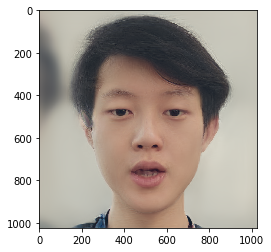

In [11]:
ShowModelOutput(FaceModel(TseData.W_ID.cuda()))

In [10]:
SaveFaceSpace(FaceData=TseData, DataPath='Pose Transfer/TseData_ID.obj')

FaceData saved to  Pose Transfer/TseData_ID.obj


In [3]:
TseData = LoadFaceSpace(DataPath='Pose Transfer/TseData_ID.obj', UseCuda=False, GetFeatureMaps=False)

### Make a new FaceData object for another identity and train for identity and pose vectors

Getting tensors of (aligned) face images
Using default Wspace - zero matrix of dim  26


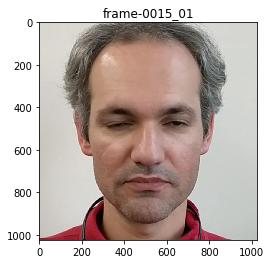

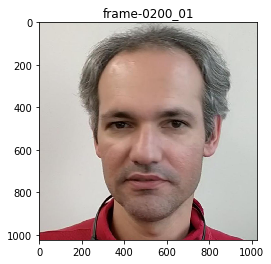

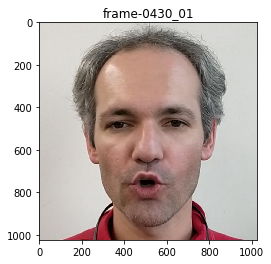

Reshaped Wspace to match number of stored faces, Wspace dim:  torch.Size([26, 18, 512])
Setting Wspaces to be the mean latent vector from  W_mean.pt


In [38]:
AliData = MakeFaceData(AlignedFaceDir='Pose Transfer/aligned_ali_test', Zdims=68*2, UseCuda=False,
                        GetFacesFeatures=False, GetLandmarks=False, PrintInterval=10)
AliData.W_ID = torch.zeros(1, 18, 512)
AliData.W_ID.requires_grad = True
AliData.Wspace = torch.ones_like(AliData.Wspace)*0.01
AliData.Wspace.requires_grad = True

In [ ]:
TrainLatentsEnc(FaceModel, AliData, Epochs_n=400, LearnRate=1e-2, BatchSize=2,\
                Weight_feature=1e2, Weight_pixel=0, Weight_PoseReg=1e1, \
                StoredTargetFeatures=False, PrintInterval=50, MaxBatchPrint=10, UseCuda=True)

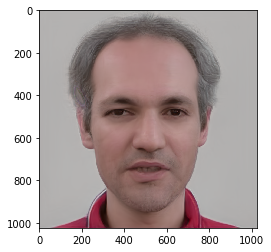

In [37]:
ShowModelOutput(FaceModel(AliData.W_ID.cuda()))

In [36]:
SaveFaceSpace(FaceData=AliData, DataPath='Pose Transfer/AliData_ID.obj')

FaceData saved to  Pose Transfer/AliData_ID.obj


In [26]:
AliData = LoadFaceSpace(DataPath='Pose Transfer/AliData_ID.obj', UseCuda=False, GetFeatureMaps=False)

### Try adding pose vectors from one face to the identity vector of another face

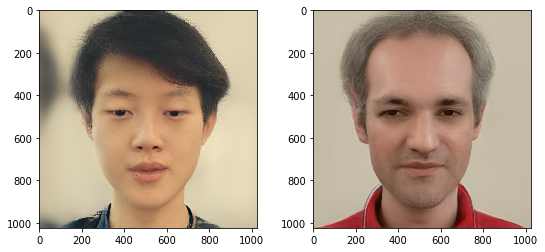

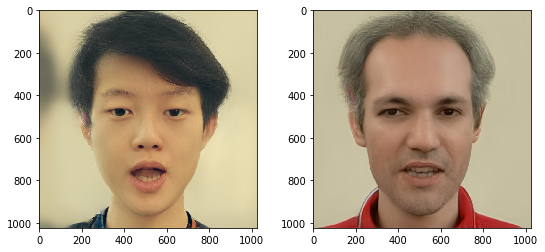

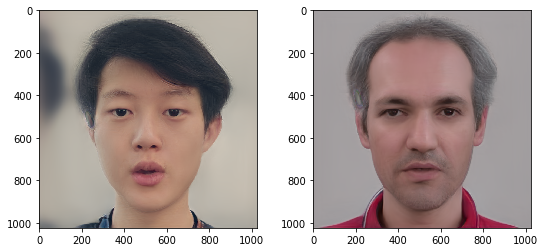

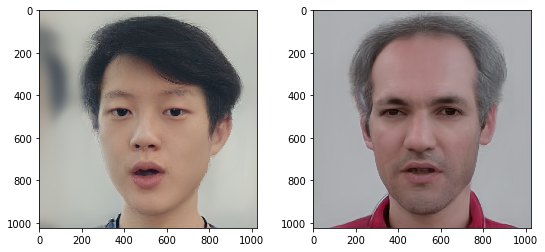

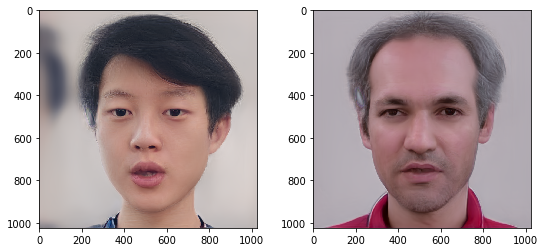

...

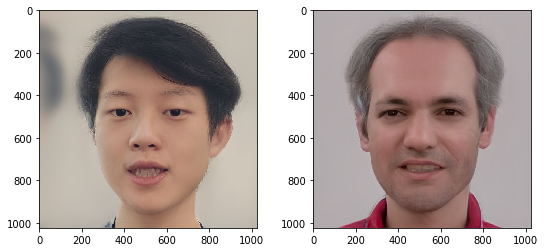

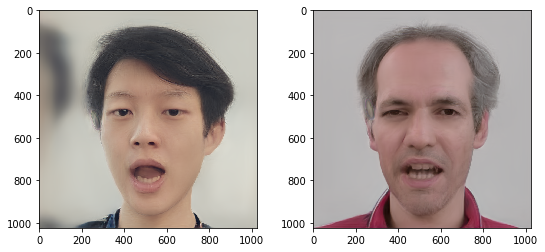

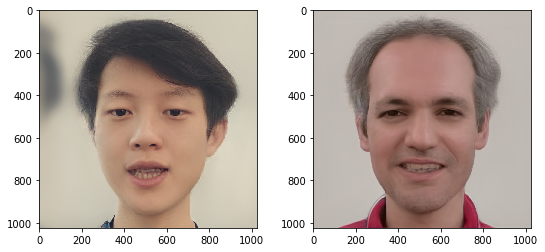

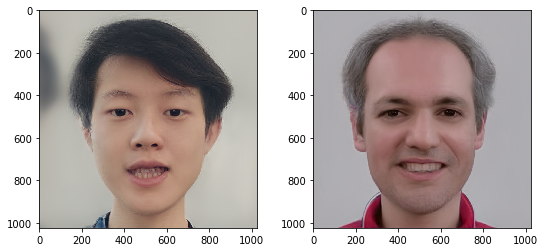

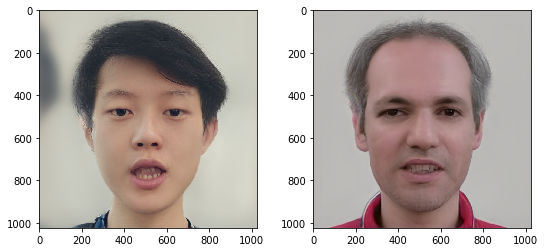

In [27]:
for Pose in TseData.Wspace:
    ModelIn = torch.cat([TseData.W_ID + Pose, AliData.W_ID + Pose], dim=0)
    ShowModelOutput(FaceModel(ModelIn.cuda()))

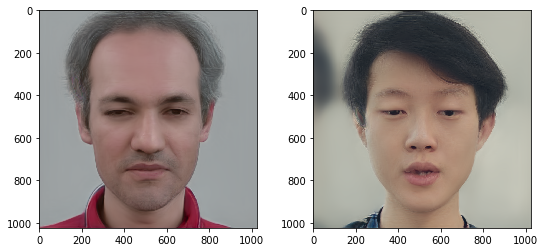

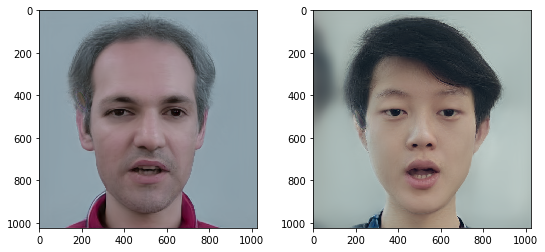

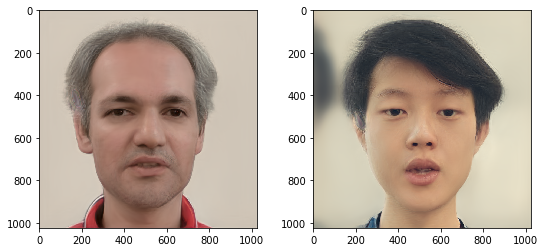

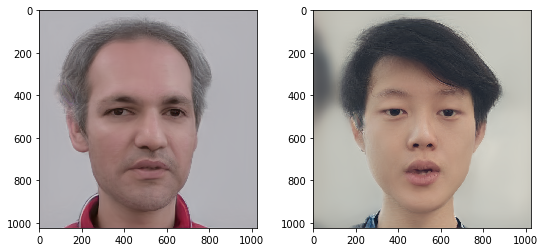

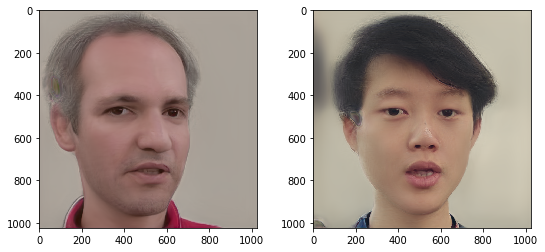

...

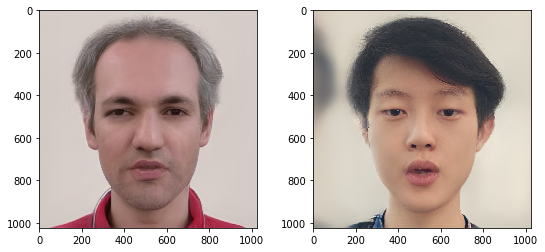

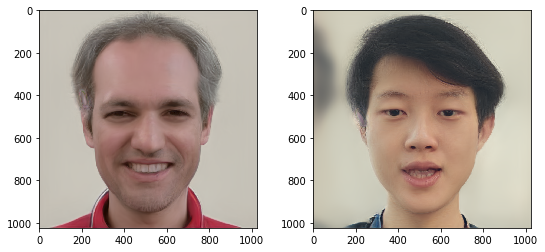

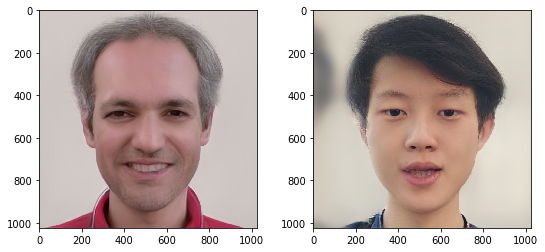

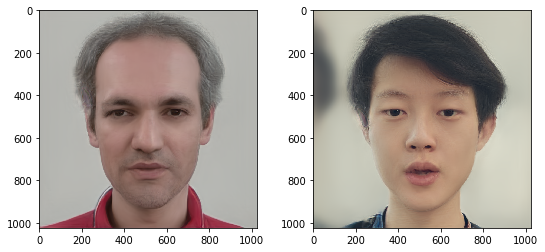

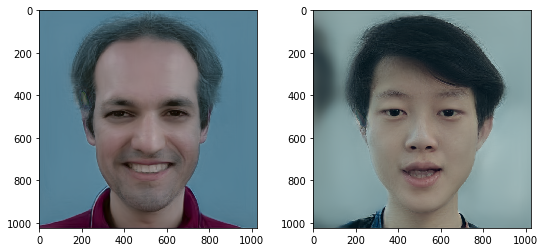

In [13]:
for Pose in AliData.Wspace:
    ModelIn = torch.cat([AliData.W_ID + Pose, TseData.W_ID + Pose*7.5e-1], dim=0)
    ShowModelOutput(FaceModel(ModelIn.cuda()))

### Tried to transfer pose to previously found W+ vector for Sakura Ayane, pose transfer not effective; possibly because W+ vector was found using only one image, and thus the vector may reside in a space where poses do not exist in the same neighbourhood

In [8]:
AyaneData = LoadFaceSpace(DataPath='Pose Transfer/AyaneData.obj', GetFeatureMaps=False)

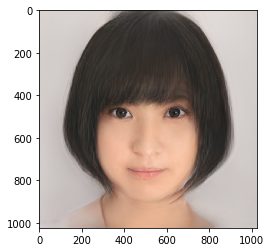

In [7]:
ShowModelOutput(FaceModel(AyaneData.Wspace.cuda()))

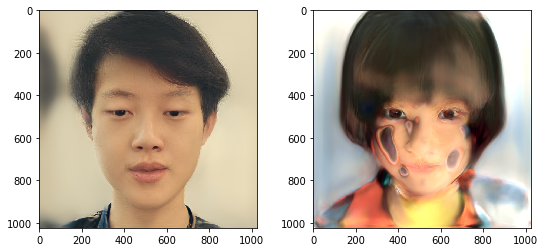

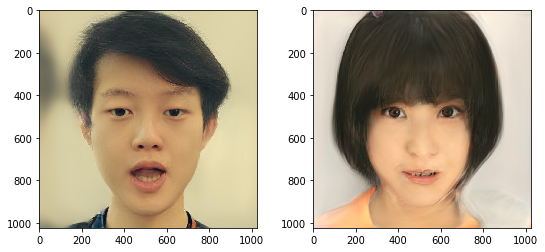

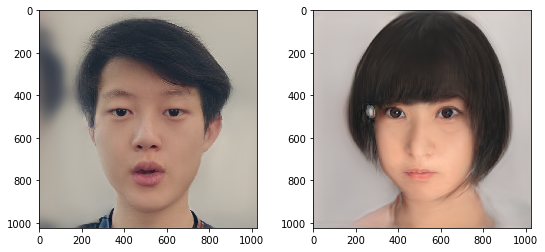

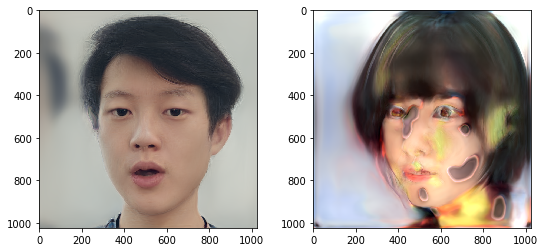

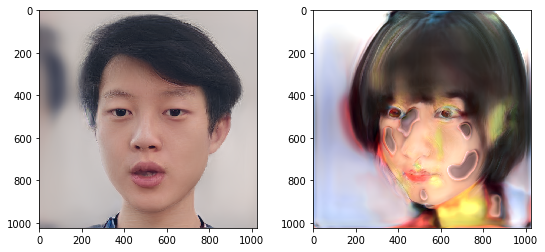

...

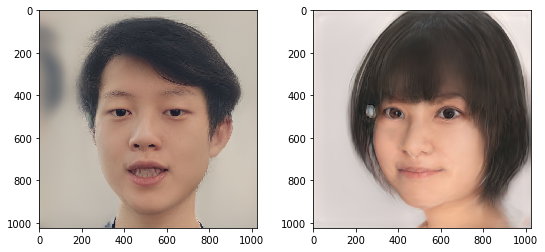

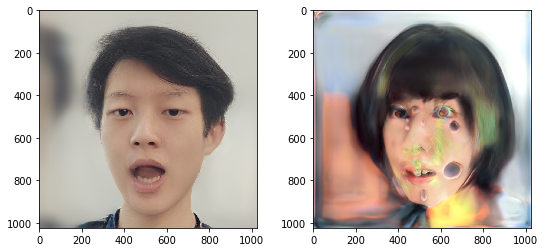

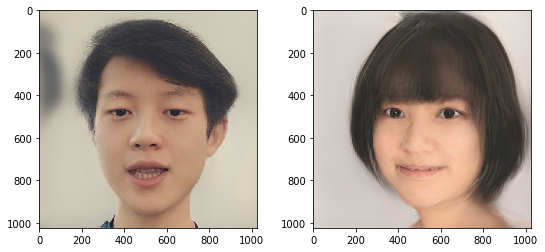

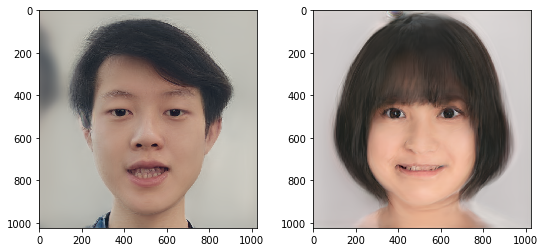

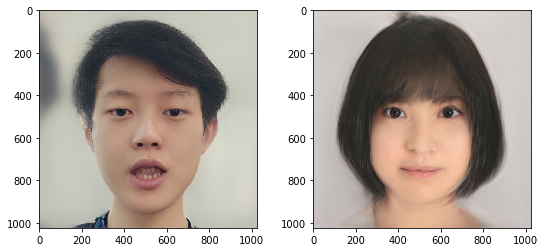

In [15]:
for Pose in TseData.Wspace:
    ModelIn = torch.cat([TseData.W_ID + Pose, AyaneData.Wspace + Pose*5e-1], dim=0)
    ShowModelOutput(FaceModel(ModelIn.cuda()))

### Try with glasses on and with more angles this time

In [ ]:
TseGlassData = MakeFaceData(AlignedFaceDir='Pose Transfer/frames/aligned', Zdims=68*2, UseCuda=False,
                       GetFacesFeatures=False, GetLandmarks=False, PrintInterval=10)
TseGlassData.W_ID = torch.zeros(1, 18, 512)
TseGlassData.W_ID.requires_grad = True
# Don't initialise pose vectors to zero, this destroys gradients after one epoch for some reason
TseGlassData.Wspace = torch.ones_like(TseGlassData.Wspace)*0.01
TseGlassData.Wspace.requires_grad = True

In [ ]:
TrainLatentsEnc(FaceModel, TseGlassData, Epochs_n=200, LearnRate=1e-2, BatchSize=2,\
                Weight_feature=1e2, Weight_pixel=0, Weight_PoseReg=1e1, \
                StoredTargetFeatures=False, PrintInterval=50, MaxBatchPrint=10, UseCuda=True)

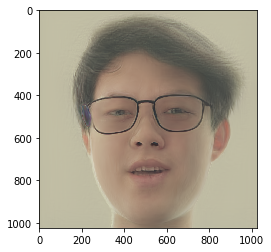

In [56]:
ShowModelOutput(FaceModel(TseGlassData.W_ID.cuda()))

In [57]:
SaveFaceSpace(FaceData=TseGlassData, DataPath='Pose Transfer/TseGlass_ID.obj')

FaceData saved to  Pose Transfer/TseGlass_ID.obj


In [10]:
TseGlassData = LoadFaceSpace(DataPath='Pose Transfer/TseGlass_ID.obj', UseCuda=False, GetFeatureMaps=False)

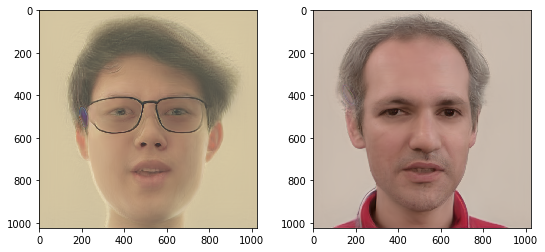

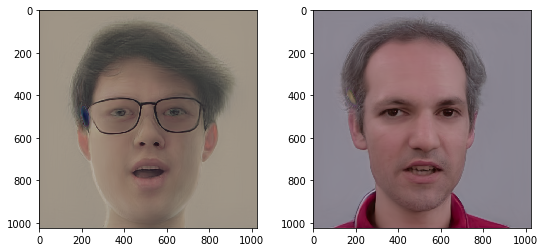

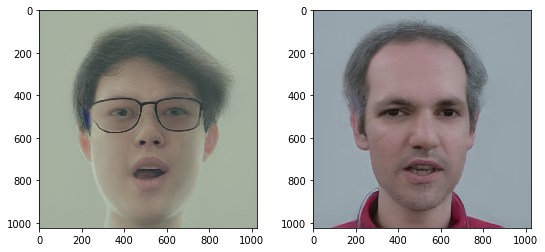

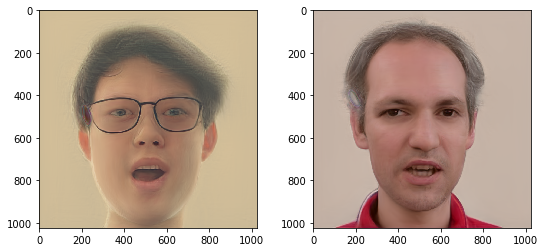

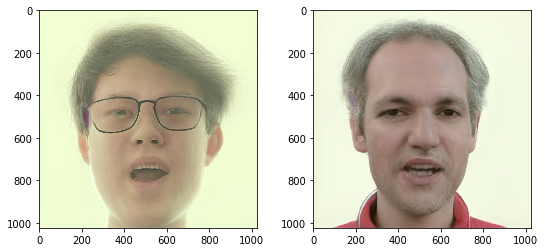

...

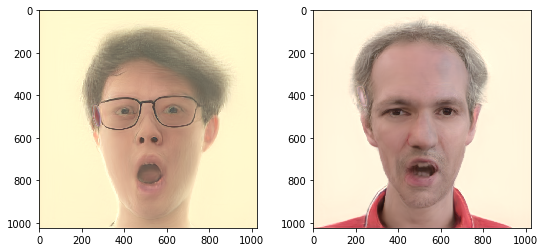

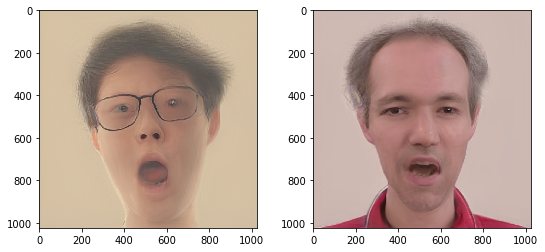

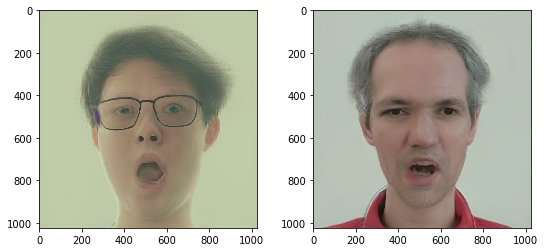

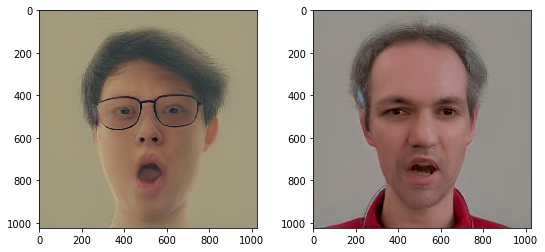

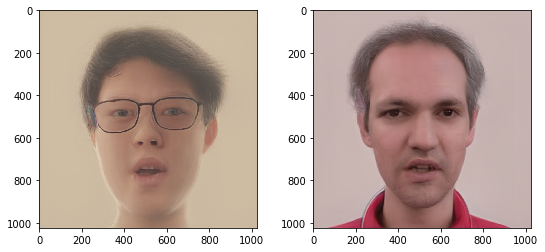

In [16]:
for Pose in TseGlassData.Wspace:
    ModelIn = torch.cat([TseGlassData.W_ID + Pose, AliData.W_ID + Pose], dim=0)
    ShowModelOutput(FaceModel(ModelIn.cuda()))

### Plot the vectors of the three identities we found in a reduced dimensionality
#### Dimensionality of 18x512 vectors reduced to 2D using random orthogonal matrices

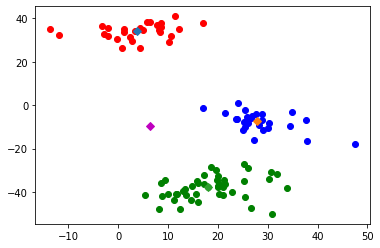

In [58]:
RandOrtho = ortho_group.rvs(2,512*18)
RandOrtho = RandOrtho[:,:,0]

W_np = torch.flatten(TseData.Wspace + TseData.W_ID, start_dim=1).cpu().detach()
W_reduced = np.dot(W_np, RandOrtho)
plt.plot(W_reduced[:,0], W_reduced[:,1], 'ro')

W_np_avg = torch.flatten(TseData.W_ID, start_dim=0).cpu().detach()
W_avg_reduced = np.dot(W_np_avg, RandOrtho)
plt.plot(W_avg_reduced[0], W_avg_reduced[1], 'D')

W_np = torch.flatten(AliData.Wspace + AliData.W_ID, start_dim=1).cpu().detach()
W_reduced = np.dot(W_np, RandOrtho)
plt.plot(W_reduced[:,0], W_reduced[:,1], 'bo')

W_np_avg = torch.flatten(AliData.W_ID, start_dim=0).cpu().detach()
W_avg_reduced = np.dot(W_np_avg, RandOrtho)
plt.plot(W_avg_reduced[0], W_avg_reduced[1], 'D')

W_np = torch.flatten(TseGlassData.Wspace + TseGlassData.W_ID, start_dim=1).cpu().detach()
W_reduced = np.dot(W_np, RandOrtho)
plt.plot(W_reduced[:,0], W_reduced[:,1], 'go')

W_np_avg = torch.flatten(TseGlassData.W_ID, start_dim=0).cpu().detach()
W_avg_reduced = np.dot(W_np_avg, RandOrtho)
plt.plot(W_avg_reduced[0], W_avg_reduced[1], 'D')

W_else = torch.flatten(AyaneData.Wspace, start_dim=0).cpu().detach()
W_else_reduced = np.dot(W_else, RandOrtho)
plt.plot(W_else_reduced[0], W_else_reduced[1], 'mD')